# Quansight demo

In [1]:
from lsst.daf.persistence import Butler

butler = Butler('/project/tmorton/tickets/DM-20015/RC2_w18')
# butler = Butler('/project/tmorton/tickets/DM-19684')

In [2]:
tract = 9813
filt = 'HSC-I'
coaddParq = butler.get('analysisCoaddTable_forced', tract=tract, filter=filt)
coaddParq

## Note on LSST stack and Parquet tables

In the LSST stack, we use a custom parquet wrapper on top of pyarrow.  You can dump them into a dataframe with the `toDataFrame()` m

In [3]:
len(coaddParq.columns)

666

In [5]:
coaddParq.toDataFrame(columns=['coord_ra', 'coord_dec']).head()

,coord_ra,coord_dec
id,,
43158167852417025,2.630391,0.026401
43158167852417026,2.630401,0.026400
43158167852417027,2.630479,0.026404
43158167852417028,2.630507,0.026404
43158167852417029,2.630598,0.026419


In [6]:
visitMatchParq = butler.get('visitMatchTable', tract=tract, filter=filt)

In [7]:
visitMatchParq.toDataFrame().head()

matchId                                                  \
                    19712 30482 30484 30486 30488 30490 30492 30494 30496   
id                                                                          
43158167852417025     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
43158167852417026     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
43158167852417027     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
43158167852417028     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
43158167852417029     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   

                         ... distance                                          \
                  30498  ...    1246  1248  19680 19682 19684     19694 19696   
id                       ...                                                    
43158167852417025   NaN  ...      NaN   NaN   NaN   NaN   NaN  0.052876   NaN   
43158167852417026   NaN  ...      NaN   NaN   NaN   NaN   NaN  0.084891   NaN   
43158167852417027   NaN  ...      NaN   NaN   NaN   NaN   NaN  0.113623   NaN   
43158167852417028   NaN  ...      NaN   NaN   NaN   NaN   NaN  0.133669   NaN   
43158167852417029   NaN  ...      NaN   NaN   NaN   NaN   NaN  0.033980   NaN   

                                     
                  19698 19708 19710  
id                                   
43158167852417025   NaN   NaN   NaN  
43158167852417026   NaN   NaN   NaN  
43158167852417027   NaN   NaN   NaN  
43158167852417028   NaN   NaN   NaN  
43158167852417029   NaN   NaN   NaN  

[5 rows x 66 columns]

In [12]:
visitMatchParq.toDataFrame()['distance'][19694]

id
43158167852417025    0.052876
43158167852417026    0.084891
43158167852417027    0.113623
43158167852417028    0.133669
43158167852417029    0.033980
43158167852417030    0.000562
43158167852417031    0.002746
43158167852417033    0.036843
43158167852417036    0.067365
43158167852417037    0.001669
43158167852417038    0.089334
43158167852417039    0.000628
43158167852417043    0.000465
43158167852417045    0.062171
43158167852417046    0.094894
43158167852417047    0.000452
43158167852417048    0.000048
43158167852417050    0.000499
43158167852417051    0.004319
43158167852417052    0.000161
43158167852417054    0.050939
43158167852417056    0.001080
43158167852417057    0.000552
43158167852417060    0.000340
43158167852417061    0.001428
43158167852417062    0.069919
43158167852417063    0.001056
43158167852417064    0.000901
43158167852417065    0.000812
43158167852417066    0.001296
                       ...   
43159164284836113         NaN
43159164284836114         NaN
4315916

## Setup data for visualization (previous TDM development)

In [13]:
from lsst.daf.persistence import Butler
from lsst.qa.explorer.functors import StarGalaxyLabeller, Magnitude 

butler = Butler('/project/tmorton/tickets/DM-19684')

tract = 9813
filt = 'HSC-I'
coaddParq = butler.get('analysisCoaddTable_forced', tract=tract, filter=filt)


labeller = StarGalaxyLabeller()

labels = labeller(coaddParq)

labels.describe()

count     1615018
unique          3
top        galaxy
freq      1175532
Name: label, dtype: object

In [14]:
from lsst.qa.explorer.functors import StarGalaxyLabeller, Magnitude, RAColumn, DecColumn, CompositeFunctor

funcs = CompositeFunctor({'label': StarGalaxyLabeller(), 
                          'psfMag': Magnitude('base_PsfFlux_instFlux'),
                          'ra': RAColumn(),
                          'dec': DecColumn()})

newCols = funcs(coaddParq)

In [15]:
newCols.head()

,dec,label,psfMag,ra
id,,,,
43158167852417025,1.512680,null,51.782054,150.710282
43158167852417026,1.512587,null,52.137755,150.710889
43158167852417027,1.512819,null,51.676951,150.715370
43158167852417028,1.512865,null,51.947719,150.716957
43158167852417029,1.513704,null,51.564187,150.722138


In [17]:
metric_columns = ['base_Footprint_nPix', 'Gaussian-PSF_magDiff_mmag'
                  'CircAper12pix-PSF_magDiff_mmag', 'Kron-PSF_magDiff_mmag',
                  'CModel-PSF_magDiff_mmag', 'traceSdss_pixel',
                  'traceSdss_fwhm_pixel', 'psfTraceSdssDiff_percent',
                  'e1ResidsSdss_milli', 'e2ResidsSdss_milli',
                  'deconvMoments', 'compareUnforced_Gaussian_magDiff_mmag',
                  'compareUnforced_CircAper12pix_magDiff_mmag',
                  'compareUnforced_Kron_magDiff_mmag',
                  'compareUnforced_CModel_magDiff_mmag']

flag_columns = ['deblend_nChild',
                'calib_psf_used', 'calib_psf_candidate', 'calib_photometry_reserved',
                'merge_measurement_i2', 'merge_measurement_i', 'merge_measurement_r2',
                'merge_measurement_r', 'merge_measurement_z', 'merge_measurement_y',
                'merge_measurement_g', 'merge_measurement_N921', 'merge_measurement_N816',
                'merge_measurement_N1010', 'merge_measurement_N387', 'merge_measurement_N515',
                'qaBad_flag']

id_columns = ['patchId', 'id']

In [18]:
import pandas as pd

df = pd.concat([coaddParq.toDataFrame(columns=metric_columns + flag_columns + id_columns), newCols], axis=1)

In [19]:
df.head()

,base_Footprint_nPix,Kron-PSF_magDiff_mmag,CModel-PSF_magDiff_mmag,traceSdss_pixel,traceSdss_fwhm_pixel,psfTraceSdssDiff_percent,e1ResidsSdss_milli,e2ResidsSdss_milli,deconvMoments,compareUnforced_Gaussian_magDiff_mmag,...,merge_measurement_N816,merge_measurement_N1010,merge_measurement_N387,merge_measurement_N515,qaBad_flag,patchId,dec,label,psfMag,ra
id,,,,,,,,,,,,,,,,,,,,,
43158167852417025,175,NaN,NaN,162.578732,382.843656,NaN,NaN,NaN,NaN,-0.0,...,False,False,False,False,True,"1,0",1.512680,null,51.782054,150.710282
43158167852417026,61,-1977.403292,NaN,73.303763,172.617171,192.223350,53.115386,-89.637213,10742.658715,-0.0,...,False,False,False,False,True,"1,0",1.512587,null,52.137755,150.710889
43158167852417027,115,-2007.433527,NaN,150.563717,354.550459,196.177330,110.468322,32.343635,45334.644804,-0.0,...,False,False,False,False,True,"1,0",1.512819,null,51.676951,150.715370
43158167852417028,29,-2542.925100,NaN,174.510927,410.941829,196.697715,124.828511,-63.228773,60903.906581,-0.0,...,False,False,False,False,True,"1,0",1.512865,null,51.947719,150.716957
43158167852417029,542,-2685.293018,NaN,102.555395,241.499500,194.415676,35.267897,-124.755718,21031.001334,-0.0,...,False,False,False,False,True,"1,0",1.513704,null,51.564187,150.722138


In [20]:
len(df.columns)

35

In [21]:
from lsst.qa.explorer.dataset import QADataset

vdims = ['base_Footprint_nPix', 'Gaussian-PSF_magDiff_mmag',
         'CModel-PSF_magDiff_mmag', 'psfTraceSdssDiff_percent',
         'e1ResidsSdss_milli', 'e2ResidsSdss_milli', 'compareUnforced_Gaussian_magDiff_mmag']

dataset = QADataset(df, vdims=vdims)

In [22]:
dataset.flags

['calib_psf_used',
 'calib_psf_candidate',
 'calib_photometry_reserved',
 'merge_measurement_i2',
 'merge_measurement_i',
 'merge_measurement_r2',
 'merge_measurement_r',
 'merge_measurement_z',
 'merge_measurement_y',
 'merge_measurement_g',
 'merge_measurement_N921',
 'merge_measurement_N816',
 'merge_measurement_N1010',
 'merge_measurement_N387',
 'merge_measurement_N515',
 'qaBad_flag']

In [23]:
dataset.vdims

['base_Footprint_nPix',
 'CModel-PSF_magDiff_mmag',
 'psfTraceSdssDiff_percent',
 'e1ResidsSdss_milli',
 'e2ResidsSdss_milli',
 'compareUnforced_Gaussian_magDiff_mmag']

In [24]:
dataset.ds

:Dataset   [calib_psf_used,calib_psf_candidate,calib_photometry_reserved,merge_measurement_i2,merge_measurement_i,merge_measurement_r2,merge_measurement_r,merge_measurement_z,merge_measurement_y,merge_measurement_g,merge_measurement_N921,merge_measurement_N816,merge_measurement_N1010,merge_measurement_N387,merge_measurement_N515,qaBad_flag,patchId,dec,label,psfMag,ra]   (base_Footprint_nPix,CModel-PSF_magDiff_mmag,psfTraceSdssDiff_percent,e1ResidsSdss_milli,e2ResidsSdss_milli,compareUnforced_Gaussian_magDiff_mmag)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
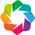

:Layout
   .DynamicMap.I     :DynamicMap   [label]
      :Table   [base_Footprint_nPix]
   .DynamicMap.II    :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,base_Footprint_nPix]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,base_Footprint_nPix]   (R,G,B,A)
   .DynamicMap.III   :DynamicMap   [label]
      :Image   [ra,dec]   (base_Footprint_nPix)
   .DynamicMap.IV    :DynamicMap   [label]
      :Table   [CModel-PSF_magDiff_mmag]
   .DynamicMap.V     :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,CModel-PSF_magDiff_mmag]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,CModel-PSF_magDiff_mmag]   (R,G,B,A)
   .DynamicMap.VI    :DynamicMap   [label]
      :Image   [ra,dec]   (CModel-PSF_magDiff_mmag)
   .DynamicMap.VII   :DynamicMap   [label]
      :Table   [psfTraceSdssDiff_percent]
   .DynamicMap.VIII  :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,psfTraceSdssDiff_percent]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,psfTraceSdssDiff_percent]   (R,G,B,A)
   .DynamicMap.IX    :DynamicMap   [label]
      :Image   [ra,dec]   (psfTraceSdssDiff_percent)
   .DynamicMap.X     :DynamicMap   [label]
      :Table   [e1ResidsSdss_milli]
   .DynamicMap.XI    :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,e1ResidsSdss_milli]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,e1ResidsSdss_milli]   (R,G,B,A)
   .DynamicMap.XII   :DynamicMap   [label]
      :Image   [ra,dec]   (e1ResidsSdss_milli)
   .DynamicMap.XIII  :DynamicMap   [label]
      :Table   [e2ResidsSdss_milli]
   .DynamicMap.XIV   :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,e2ResidsSdss_milli]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,e2ResidsSdss_milli]   (R,G,B,A)
   .DynamicMap.XV    :DynamicMap   [label]
      :Image   [ra,dec]   (e2ResidsSdss_milli)
   .DynamicMap.XVI   :DynamicMap   [label]
      :Table   [compareUnforced_Gaussian_magDiff_mmag]
   .DynamicMap.XVII  :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,compareUnforced_Gaussian_magDiff_mmag]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,compareUnforced_Gaussian_magDiff_mmag]   (R,G,B,A)
   .DynamicMap.XVIII :DynamicMap   [label]
      :Image   [ra,dec]   (compareUnforced_Gaussian_magDiff_mmag)

In [25]:
import holoviews as hv
hv.extension('bokeh')

from lsst.qa.explorer.plots import FilterStream, multi_scattersky, scattersky

filter_stream = FilterStream()
multi_scattersky(dataset.ds.groupby('label'), filter_stream=filter_stream, width=900, height=300, xdim='psfMag')

In [28]:
from lsst.qa.explorer.plots import FlagSetter
import parambokeh

flag_setter = FlagSetter(filter_stream=filter_stream, flags=data15.flags, bad_flags=data15.flags)
parambokeh.Widgets(flag_setter, callback=flag_setter.event, push=False, on_init=True)

ModuleNotFoundError: No module named 'parambokeh'

In [22]:
scattersky(dataset.ds.groupby('label'), xdim='psfMag', ydim='CModel-PSF_magDiff_mmag')

:Layout
   .DynamicMap.I   :DynamicMap   [label]
      :Table   [CModel-PSF_magDiff_mmag]
   .DynamicMap.II  :DynamicMap   [label]
      :Overlay
         .RGB.I  :RGB   [psfMag,CModel-PSF_magDiff_mmag]   (R,G,B,A)
         .RGB.II :RGB   [psfMag,CModel-PSF_magDiff_mmag]   (R,G,B,A)
   .DynamicMap.III :DynamicMap   [label]
      :Image   [ra,dec]   (CModel-PSF_magDiff_mmag)

In [19]:
[print(c) for c in coaddParq.columns];

coord_ra
coord_dec
parent
deblend_nChild
base_SdssCentroid_x
base_SdssCentroid_y
base_SdssCentroid_xErr
base_SdssCentroid_yErr
base_SdssCentroid_flag
base_SdssCentroid_flag_edge
base_SdssCentroid_flag_noSecondDerivative
base_SdssCentroid_flag_almostNoSecondDerivative
base_SdssCentroid_flag_notAtMaximum
base_SdssCentroid_flag_resetToPeak
base_TransformedCentroid_x
slot_Centroid_x
base_TransformedCentroid_y
slot_Centroid_y
base_TransformedCentroid_flag
base_CircularApertureFlux_flag_badCentroid
base_GaussianFlux_flag_badCentroid
base_InputCount_flag_badCentroid
base_LocalBackground_flag_badCentroid
base_PsfFlux_flag_badCentroid
base_SdssCentroid_flag_badInitialCentroid
base_SdssShape_flag_badCentroid
base_Variance_flag_badCentroid
ext_convolved_ConvolvedFlux_0_flag_badCentroid
ext_convolved_ConvolvedFlux_1_flag_badCentroid
ext_convolved_ConvolvedFlux_2_flag_badCentroid
ext_convolved_ConvolvedFlux_3_flag_badCentroid
ext_convolved_ConvolvedFlux_flag_badCentroid
ext_photometryKron_KronFlux_

Metrics to compute:

* Means and std of columns
* gauss_mag repeatability in visits 
* ra, dec repeatability in visits
* make dynamic selections possible

In [14]:
mag(coaddParq).head()

id
43158167852417025    51.782054
43158167852417026    52.137755
43158167852417027    51.676951
43158167852417028    51.947719
43158167852417029    51.564187
Name: base_PsfFlux_instFlux, dtype: float64

In [12]:
import numpy as np

1./np.power(10, -0.4*mag.COADD_ZP)

63095734448.01943

In [6]:
coaddParq.toDataFrame(columns=['base_PsfFlux_instFlux']).head(20)

,base_PsfFlux_instFlux
id,
43158167852417025,1.222302e-10
43158167852417026,8.808424e-11
43158167852417027,1.346541e-10
43158167852417028,1.049330e-10
43158167852417029,1.493912e-10
43158167852417030,1.142202e-09
43158167852417031,4.798153e-09
43158167852417033,7.933900e-11
43158167852417036,1.264641e-10
